In [1]:
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img

import tensorflow_datasets as tfds 

import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

import json
from glob import glob
from PIL import Image
import pickle
import re
import os
import time, datetime

from tqdm import tqdm

import visual_transformer as vt

In [2]:
####### GPU CONFIGS FOR RTX 2070 ###############
## Please ignore if not training on GPU       ##
## this is important for running CuDNN on GPU ##

tf.keras.backend.clear_session() #- for easy reset of notebook state

# chck if GPU can be seen by TF
tf.config.list_physical_devices('GPU')
#tf.debugging.set_log_device_placement(True)  # only to check GPU usage
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  # Restrict TensorFlow to only use the first GPU
  try:
    tf.config.experimental.set_memory_growth(gpus[0], True)
    tf.config.experimental.set_visible_devices(gpus[0], 'GPU')
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPU")
  except RuntimeError as e:
    # Visible devices must be set before GPUs have been initialized
    print(e)
###############################################

1 Physical GPUs, 1 Logical GPU


# Load Test Data and Tokenizer

In [3]:
cap_tokenizer = tfds.features.text.SubwordTextEncoder.load_from_file("captions")

# Setup Model

In [4]:
# Small Model
num_layers = 4
d_model = 128
dff = d_model * 4
num_heads = 8

In [5]:
target_vocab_size = cap_tokenizer.vocab_size  # already includes start/end tokens
dropout_rate = 0.

transformer = vt.Transformer(num_layers, d_model, num_heads, dff,
                             target_vocab_size,
                             pe_input=49,  # 7x7 pixels
                             pe_target=target_vocab_size,
                             rate=dropout_rate
                             )

In [6]:
# Learning Rate Schedule, as per `Attention is All You Need' paper
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
    def __init__(self, d_model, warmup_steps=4000):
        super(CustomSchedule, self).__init__()

        self.d_model = d_model
        self.d_model = tf.cast(self.d_model, tf.float32)

        self.warmup_steps = warmup_steps

    def __call__(self, step):
        arg1 = tf.math.rsqrt(step)
        arg2 = step * (self.warmup_steps ** -1.5)

        return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)


learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98,
                                    epsilon=1e-9)

In [18]:
checkpoint_path = "./checkpoints/train-small-model-nope-20ep"

ckpt = tf.train.Checkpoint(transformer=transformer,
                           optimizer=optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


In [8]:
# Helper function for creating masks

def create_masks(inp, tar):
    # Encoder padding mask - This should just be 1's
    # input shape should be (batch_size, 49, 2048)
    inp_seq = tf.ones([inp.shape[0], inp.shape[1]])  # all pixels to be used

    enc_padding_mask = vt.create_padding_mask(inp_seq)

    # Used in the 2nd attention block in the decoder.
    # This padding mask is used to mask the encoder outputs.
    dec_padding_mask = vt.create_padding_mask(inp_seq)

    # Used in the 1st attention block in the decoder.
    # It is used to pad and mask future tokens in the input received by
    # the decoder.
    look_ahead_mask = vt.create_look_ahead_mask(tf.shape(tar)[1])
    dec_target_padding_mask = vt.create_padding_mask(tar)
    combined_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)

    return enc_padding_mask, combined_mask, dec_padding_mask

# Inference Logic

In [9]:
def evaluate(inp_img, max_len=21):
    start_token = cap_tokenizer.encode("<s>")[0]
    end_token = cap_tokenizer.encode("</s>")[0]
    
    encoder_input = inp_img # batch of 1
    
    # start token for caption
    decoder_input = [start_token]
    output = tf.expand_dims(decoder_input, 0)
    for i in range(max_len):
        enc_padding_mask, combined_mask, dec_padding_mask = create_masks(
            encoder_input, output)
        
        # predictions.shape == (batch_size, seq_len, vocab_size)
        predictions, attention_weights = transformer(encoder_input, 
                                                     output,
                                                     False,
                                                     enc_padding_mask,
                                                     combined_mask,
                                                     dec_padding_mask)
        
        # select the last word from the seq_len dimension
        predictions = predictions[: ,-1:, :]  # (batch_size, 1, vocab_size)

        predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
        
        # return the result if the predicted_id is equal to the end token
        if predicted_id == end_token:
            return tf.squeeze(output, axis=0), attention_weights
        
        # concatentate the predicted_id to the output which is given to the decoder
        # as its input.
        output = tf.concat([output, predicted_id], axis=-1)

    return tf.squeeze(output, axis=0), attention_weights

In [20]:
def caption(image):
    end_token = cap_tokenizer.encode("</s>")[0]
    result, attention_weights = evaluate(image)
    
    predicted_caption = cap_tokenizer.decode([i for i in result 
                                              if i > end_token])  

    print('Predicted Caption: {}'.format(predicted_caption))

In [11]:
rs50 = tf.keras.applications.ResNet50(
    include_top=False,
    weights="imagenet",  #no pooling
    input_shape=(224, 224, 3)
)

In [12]:
new_input = rs50.input
hidden_layer = rs50.layers[-1].output

features_extract = tf.keras.Model(new_input, hidden_layer)
features_extract.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________________

# Examples

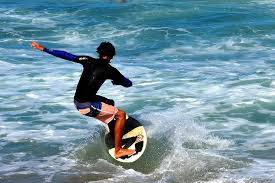

In [13]:
display(Image.open("./beach-surf.jpg"))

In [14]:
image = load_img("./beach-surf.jpg", target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet

In [15]:
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)

(1, 7, 7, 2048)
(1, 49, 2048)


In [16]:
caption(eval_img)

Predicted Caption: a man is riding a surfboard on a wave.


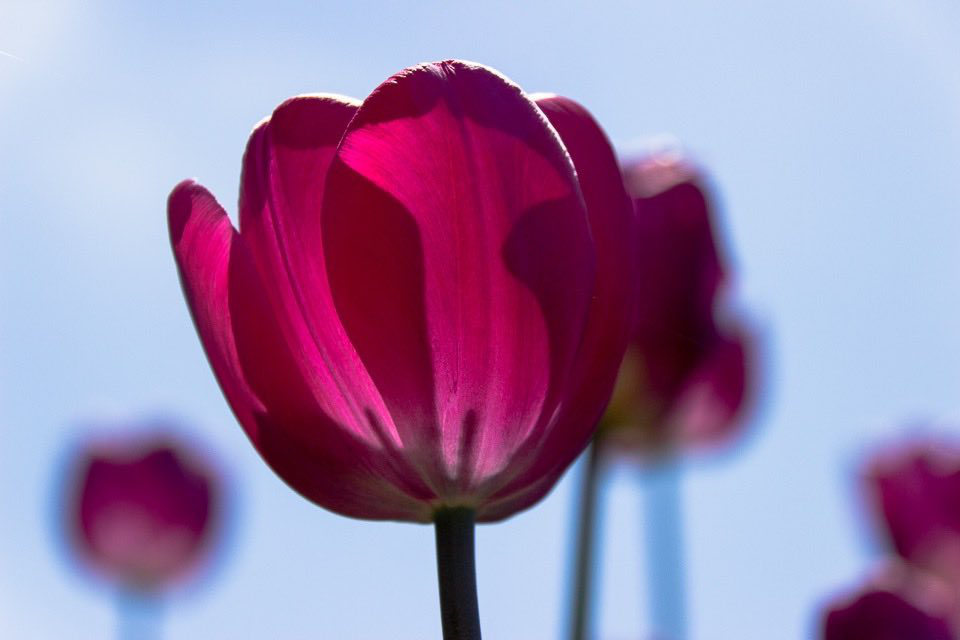

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a close up of a vase with flowers in it


In [22]:
display(Image.open("./chap7-tulip.jpg"))
image = load_img("./chap7-tulip.jpg", target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

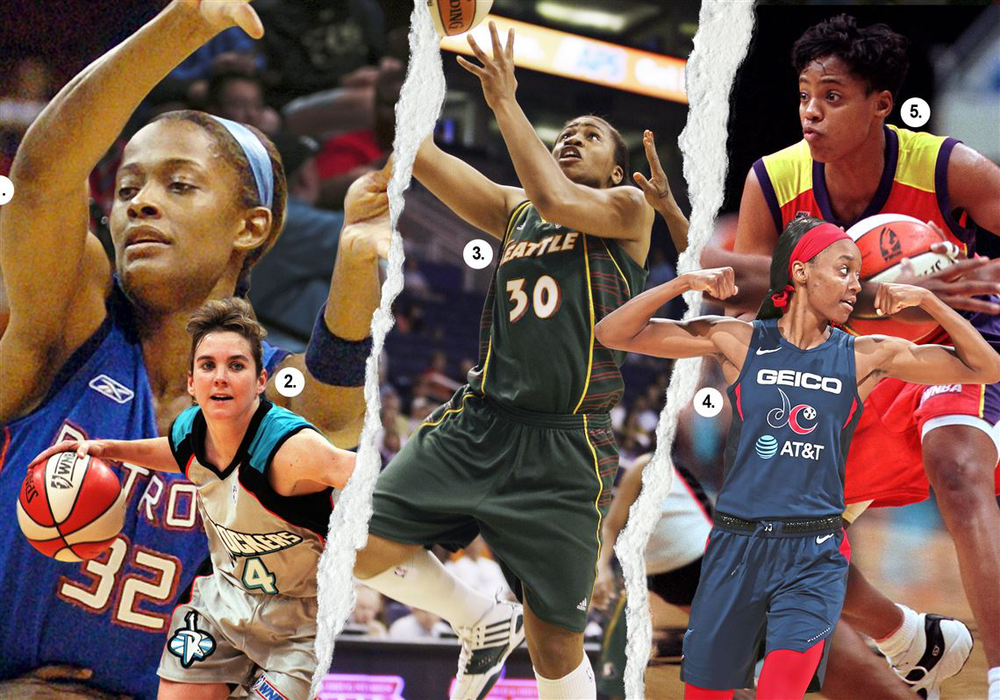

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a group of men standing next to each other on a field.


In [25]:
img = "./fab5girls3-basktball.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

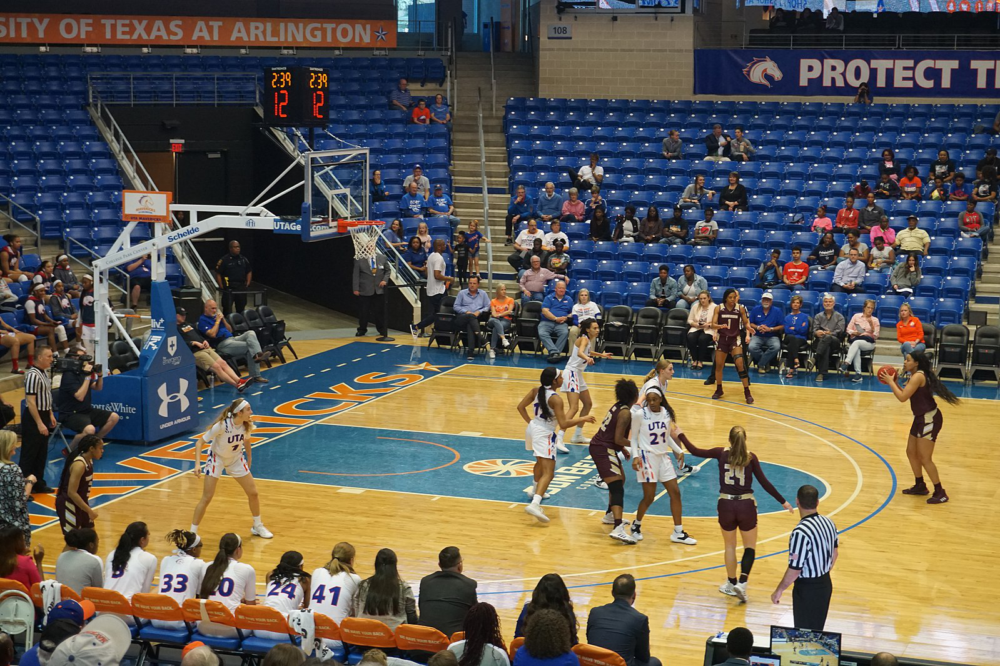

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a man is playing tennis on a court


In [27]:
img = "./women-basketball.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

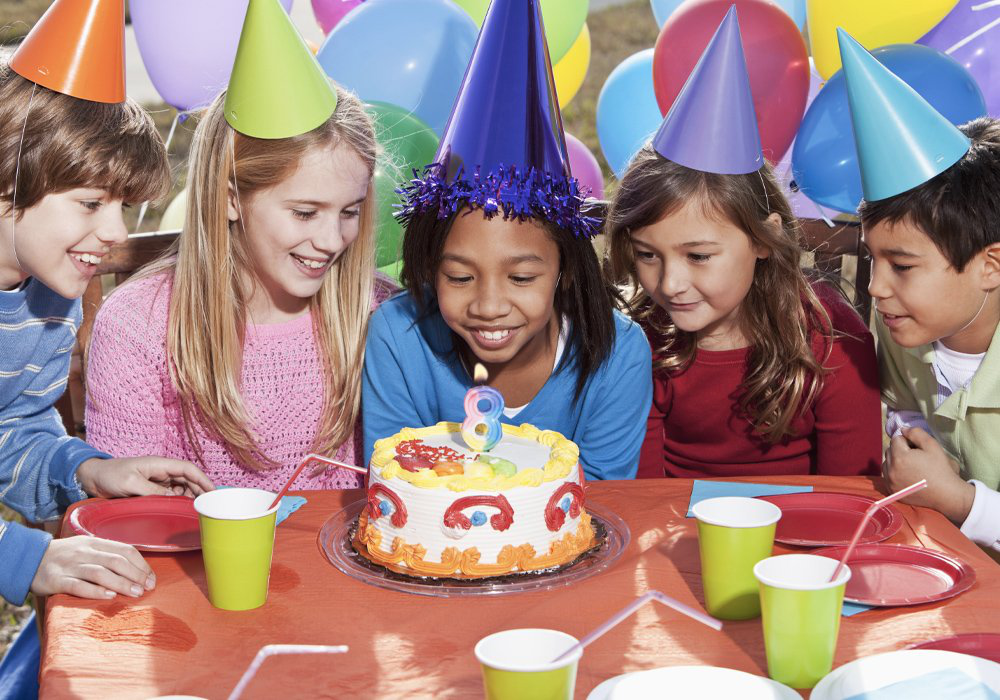

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a group of people standing around a table with a cake.


In [26]:
img = "./birthday-party.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

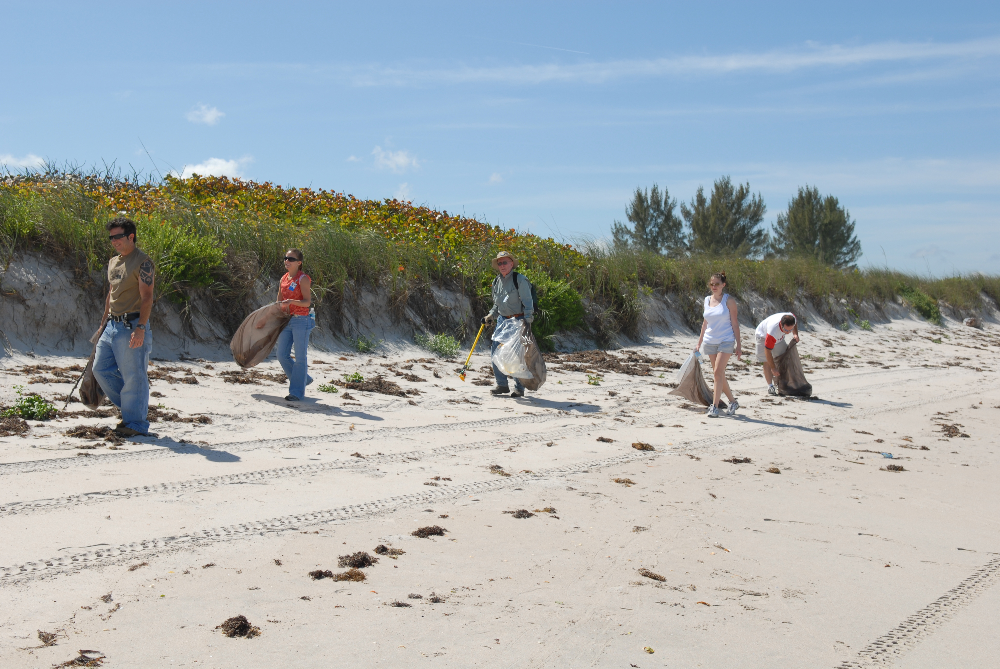

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a group of people standing on top of a sandy beach.


In [31]:
img = "./nasa-beach-cleanup.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

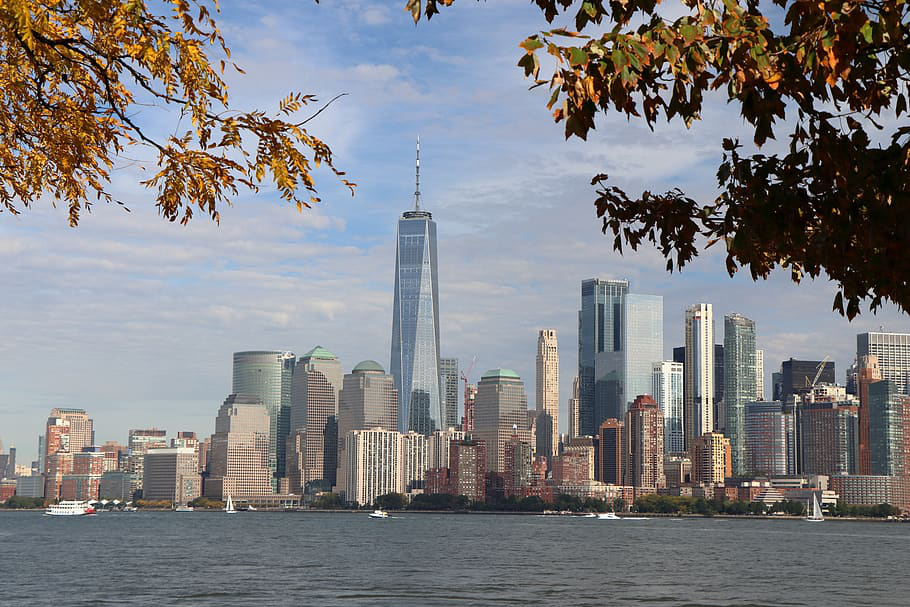

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a large body of water with a clock tower in the background.


In [32]:
img = "./manhattan-skyline.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

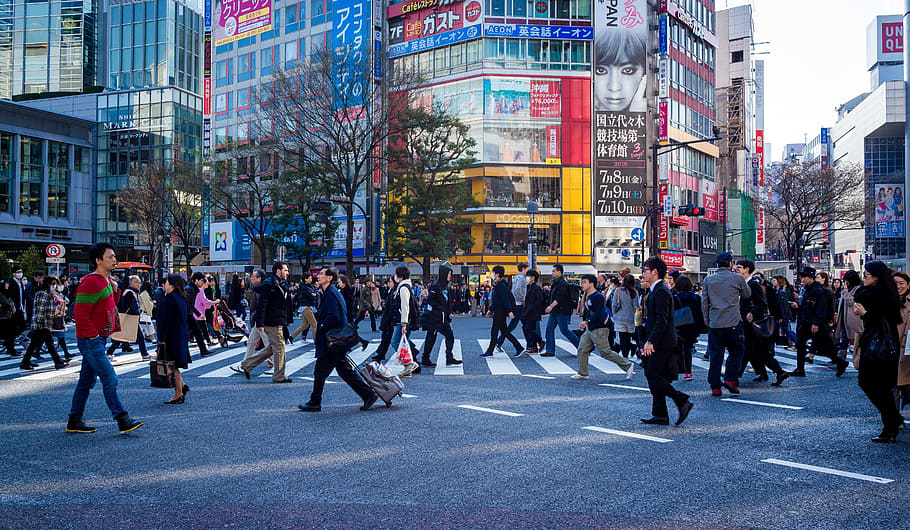

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a group of people walking down a street with luggage.


In [33]:
img = "./person-city-street-crosswalk.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

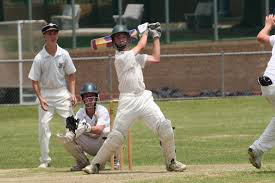

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a baseball player is standing in the middle of a field.


In [34]:
img = "./cricket.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

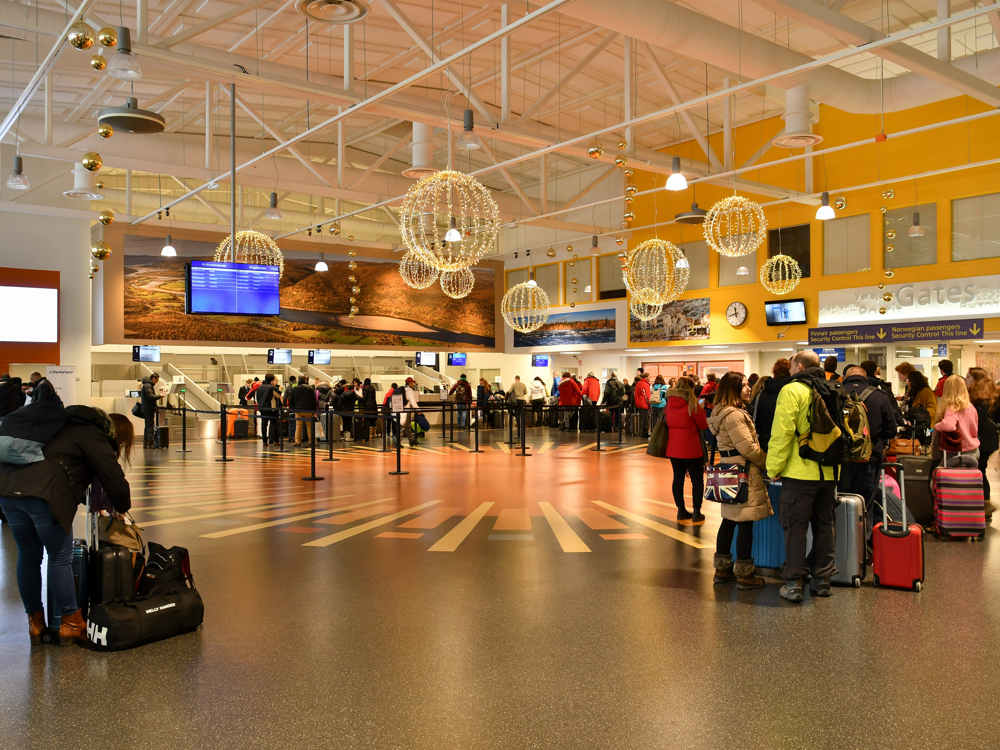

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a group of people standing around a building with luggage.


In [35]:
img = "./ivalo-airport.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

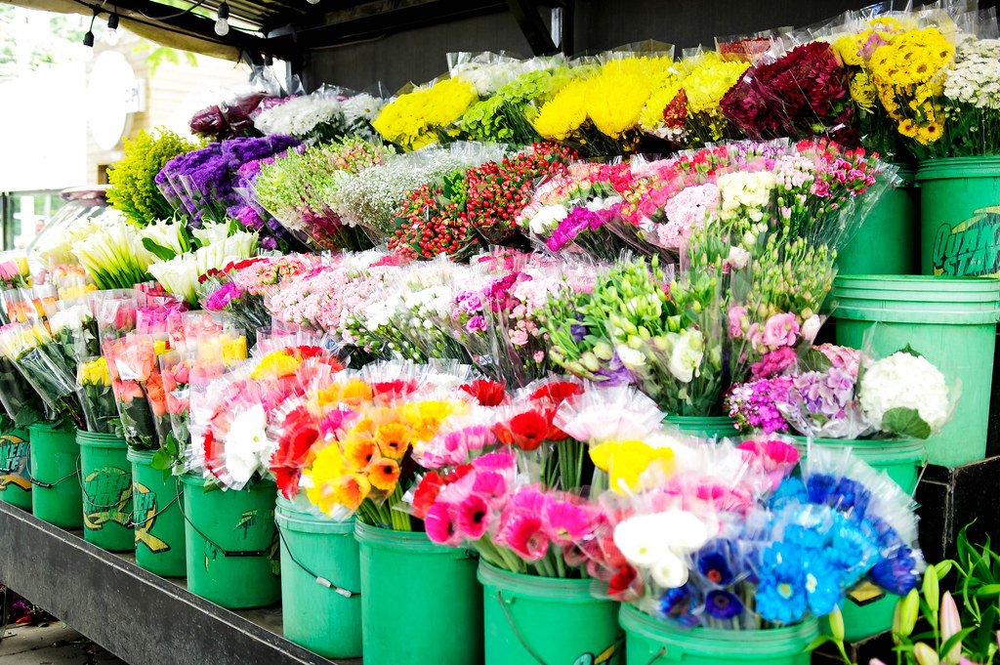

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a bunch of vases that are on a table.


In [37]:
img = "./flower-shop.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

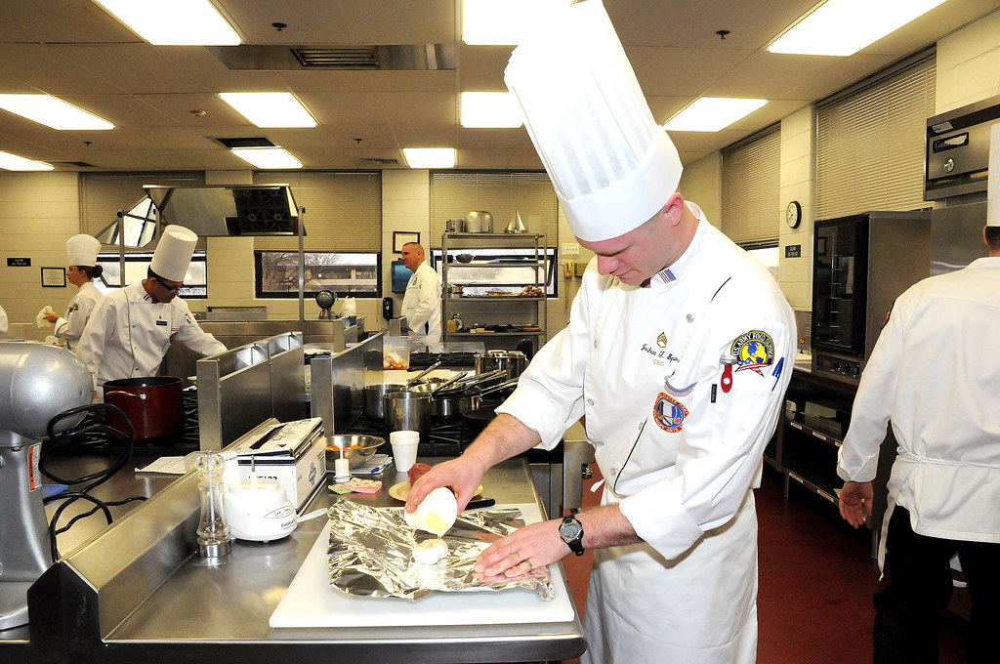

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a group of people standing around a table with food.


In [23]:
img = "./chef.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

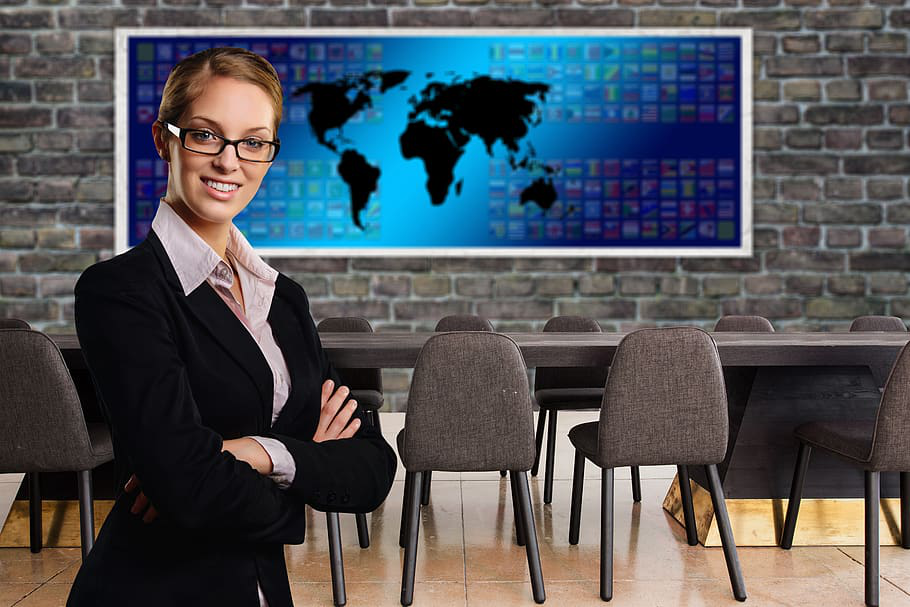

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a man in a suit and tie standing in front of a mirror.


In [24]:
img = "./businesswoman.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

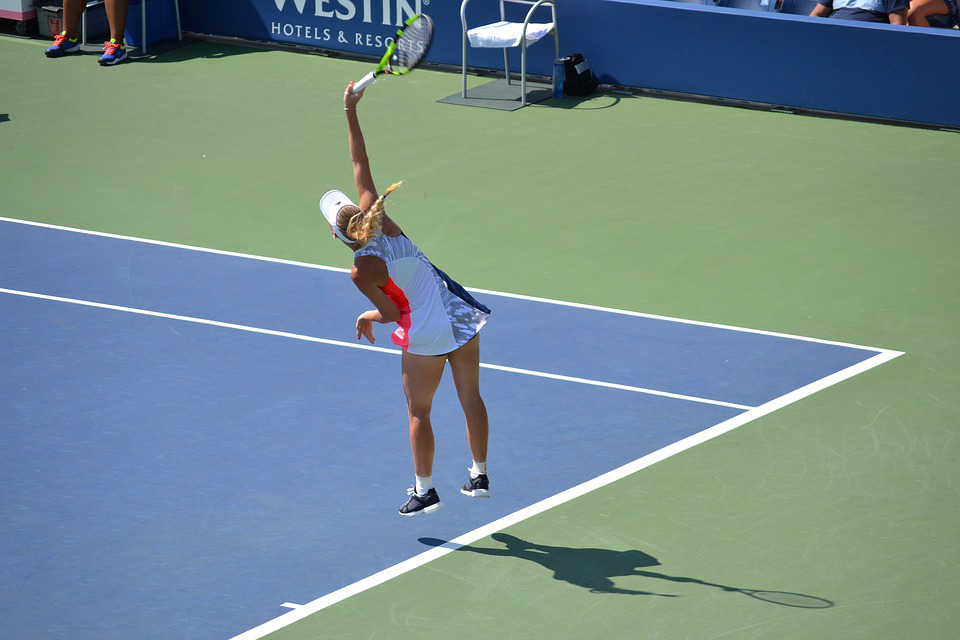

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a tennis player is hitting a ball with a racket.


In [28]:
img = "./woman-tennis.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

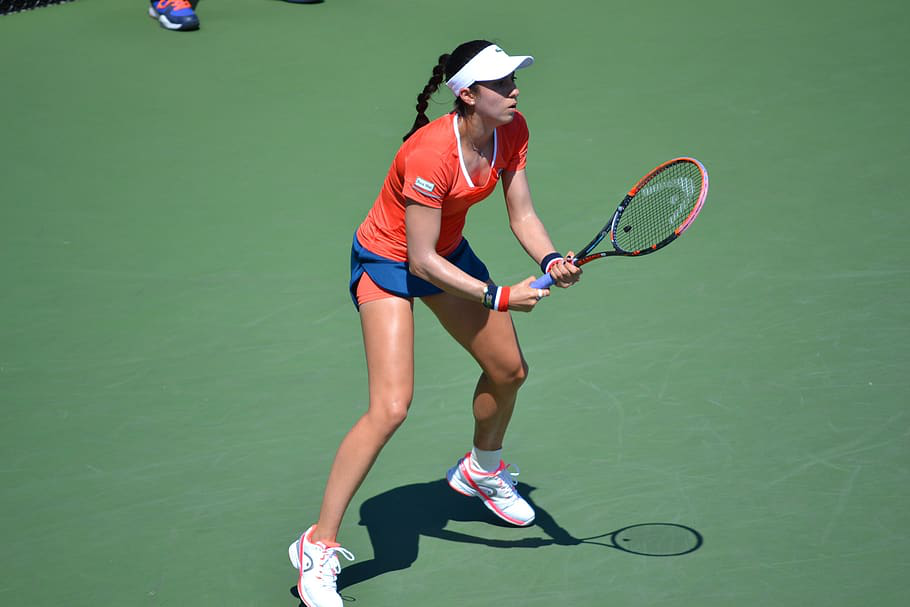

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a woman is holding a tennis racket on a court


In [29]:
img = "./tennis-player-woman-racket.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)

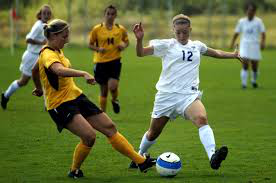

(1, 7, 7, 2048)
(1, 49, 2048)
Predicted Caption: a group of young men playing a game of soccer.


In [30]:
img = "./women-soccer.jpg"
display(Image.open(img))
image = load_img(img, target_size=(224, 224)) # from keras
image = img_to_array(image)
image = np.expand_dims(image, axis=0)  # batch of one
image = preprocess_input(image)  # from resnet
eval_img = features_extract.predict(image)
print(eval_img.shape)
eval_img = tf.reshape(eval_img, [1, 49, 2048])
print(eval_img.shape)
caption(eval_img)